# Problem Statement and Objective

In the insurance industry, predicting the likelihood of claims is critical for risk assessment and policy pricing. However, insurance claims datasets often exhibit class imbalance, with non-claims outnumbering actual claims. This imbalance can lead to predictive models that are biased towards the majority class, resulting in poor predictive performance for the minority class, which is often of greater interest.

Your task is to develop and evaluate a predictive model that accurately identifies the likelihood of insurance claims, despite the inherent class imbalance in the dataset. The model should maintain high predictive accuracy across both classes, ensuring that insurers can effectively assess risk and allocate resources.

In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

import plotly.graph_objects as go
from plotly.subplots import make_subplots

In [3]:
df = pd.read_csv('Insurance claims data.csv')
df.head()

,policy_id,subscription_length,vehicle_age,customer_age,region_code,region_density,segment,model,fuel_type,max_torque,...,is_brake_assist,is_power_door_locks,is_central_locking,is_power_steering,is_driver_seat_height_adjustable,is_day_night_rear_view_mirror,is_ecw,is_speed_alert,ncap_rating,claim_status
0,POL045360,9.3,1.2,41,C8,8794,C2,M4,Diesel,250Nm@2750rpm,...,Yes,Yes,Yes,Yes,Yes,No,Yes,Yes,3,0
1,POL016745,8.2,1.8,35,C2,27003,C1,M9,Diesel,200Nm@1750rpm,...,No,Yes,Yes,Yes,Yes,Yes,Yes,Yes,4,0
2,POL007194,9.5,0.2,44,C8,8794,C2,M4,Diesel,250Nm@2750rpm,...,Yes,Yes,Yes,Yes,Yes,No,Yes,Yes,3,0
3,POL018146,5.2,0.4,44,C10,73430,A,M1,CNG,60Nm@3500rpm,...,No,No,No,Yes,No,No,No,Yes,0,0
4,POL049011,10.1,1.0,56,C13,5410,B2,M5,Diesel,200Nm@3000rpm,...,No,Yes,Yes,Yes,No,No,Yes,Yes,5,0


In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 58592 entries, 0 to 58591
Data columns (total 41 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   policy_id                         58592 non-null  object 
 1   subscription_length               58592 non-null  float64
 2   vehicle_age                       58592 non-null  float64
 3   customer_age                      58592 non-null  int64  
 4   region_code                       58592 non-null  object 
 5   region_density                    58592 non-null  int64  
 6   segment                           58592 non-null  object 
 7   model                             58592 non-null  object 
 8   fuel_type                         58592 non-null  object 
 9   max_torque                        58592 non-null  object 
 10  max_power                         58592 non-null  object 
 11  engine_type                       58592 non-null  object 
 12  airb

Checking for null values

In [8]:
df.isnull().sum()

policy_id                           0
subscription_length                 0
vehicle_age                         0
customer_age                        0
region_code                         0
region_density                      0
segment                             0
model                               0
fuel_type                           0
max_torque                          0
max_power                           0
engine_type                         0
airbags                             0
is_esc                              0
is_adjustable_steering              0
is_tpms                             0
is_parking_sensors                  0
is_parking_camera                   0
rear_brakes_type                    0
displacement                        0
cylinder                            0
transmission_type                   0
steering_type                       0
turning_radius                      0
length                              0
width                               0
gross_weight

## Features and their description

The given dataset contains the following features:

- `policy_id`: Unique identifier for the insurance policy.
- `subscription_length`: The duration for which the insurance policy is active.
- `customer_age`: Age of the insurance policyholder, which can influence the likelihood of claims.
- `vehicle_age`: Age of the vehicle insured, which may affect the probability of claims due to factors like wear and tear.
- `model`: The model of the vehicle, which could impact the claim frequency due to model-specific characteristics.
- `fuel_type`: Type of fuel the vehicle uses (e.g., Petrol, Diesel, CNG), which might influence the risk profile and claim likelihood.
- `max_torque, max_power`: Engine performance characteristics that could relate to the vehicle’s mechanical condition and claim risks.
- `engine_type`: The type of engine, which might have implications for maintenance and claim rates.
- `displacement, cylinder`: Specifications related to the engine size and construction, affecting the vehicle’s performance and potentially its claim history.
- `region_code`: The code representing the geographical region of the policyholder, as claim patterns can vary regionally.
- `region_density`: Population density of the policyholder’s region, which could correlate with accident and claim frequencies.
- `airbags`: The number of airbags in the vehicle, indicating safety level which can influence claim probability.
is_esc (Electronic Stability Control), is_adjustable_steering, is_tpms (Tire Pressure Monitoring System): Features that enhance vehicle safety and could potentially reduce the likelihood of claims.
- `is_parking_sensors, is_parking_camera`: Parking aids that might affect the probability of making a claim, especially in urban areas.
- `rear_brakes_type`: Type of rear brakes, which could be related to the vehicle’s stopping capability and safety.
- Features like `steering_type`, `turning_radius`, `length`, `width`, `gross_weight`, and various other binary indicators (Yes/No) for specific vehicle amenities and safety features, which together build a profile of the vehicle’s characteristics and its associated risk factors.
- `claim_status`: Indicates whether a claim was made (1) or not (0), which is the dependent variable the model aims to predict.

In [11]:
df.head()

,policy_id,subscription_length,vehicle_age,customer_age,region_code,region_density,segment,model,fuel_type,max_torque,...,is_brake_assist,is_power_door_locks,is_central_locking,is_power_steering,is_driver_seat_height_adjustable,is_day_night_rear_view_mirror,is_ecw,is_speed_alert,ncap_rating,claim_status
0,POL045360,9.3,1.2,41,C8,8794,C2,M4,Diesel,250Nm@2750rpm,...,Yes,Yes,Yes,Yes,Yes,No,Yes,Yes,3,0
1,POL016745,8.2,1.8,35,C2,27003,C1,M9,Diesel,200Nm@1750rpm,...,No,Yes,Yes,Yes,Yes,Yes,Yes,Yes,4,0
2,POL007194,9.5,0.2,44,C8,8794,C2,M4,Diesel,250Nm@2750rpm,...,Yes,Yes,Yes,Yes,Yes,No,Yes,Yes,3,0
3,POL018146,5.2,0.4,44,C10,73430,A,M1,CNG,60Nm@3500rpm,...,No,No,No,Yes,No,No,No,Yes,0,0
4,POL049011,10.1,1.0,56,C13,5410,B2,M5,Diesel,200Nm@3000rpm,...,No,Yes,Yes,Yes,No,No,Yes,Yes,5,0


## Visualizing the distribution of `claim_status` column

In [14]:
df['claim_status'].value_counts().reset_index()['count']

0    54844
1     3748
Name: count, dtype: int64

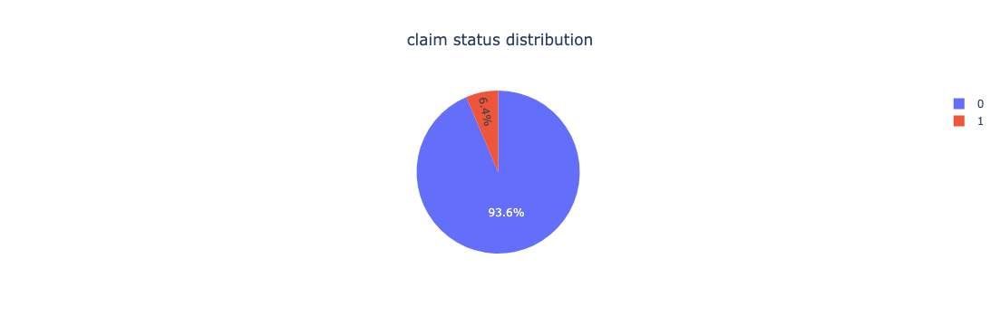

In [16]:
fig = go.Figure()
fig.add_pie(values= list(df['claim_status'].value_counts().reset_index()['count']),
            labels = list(df['claim_status'].value_counts().reset_index()['claim_status']))
fig.update_layout(title= dict(text='claim status distribution', x= 0.5))
fig.show()

**Observation**: from the above pie plot we can clearly see that their is an imbalance in the data size for predictive classes

## Data Cleaning

In [19]:
num_cols = [col for col in list(df.select_dtypes(include = ['float64','int64']).columns)]
num_cols

['subscription_length',
 'vehicle_age',
 'customer_age',
 'region_density',
 'airbags',
 'displacement',
 'cylinder',
 'turning_radius',
 'length',
 'width',
 'gross_weight',
 'ncap_rating',
 'claim_status']

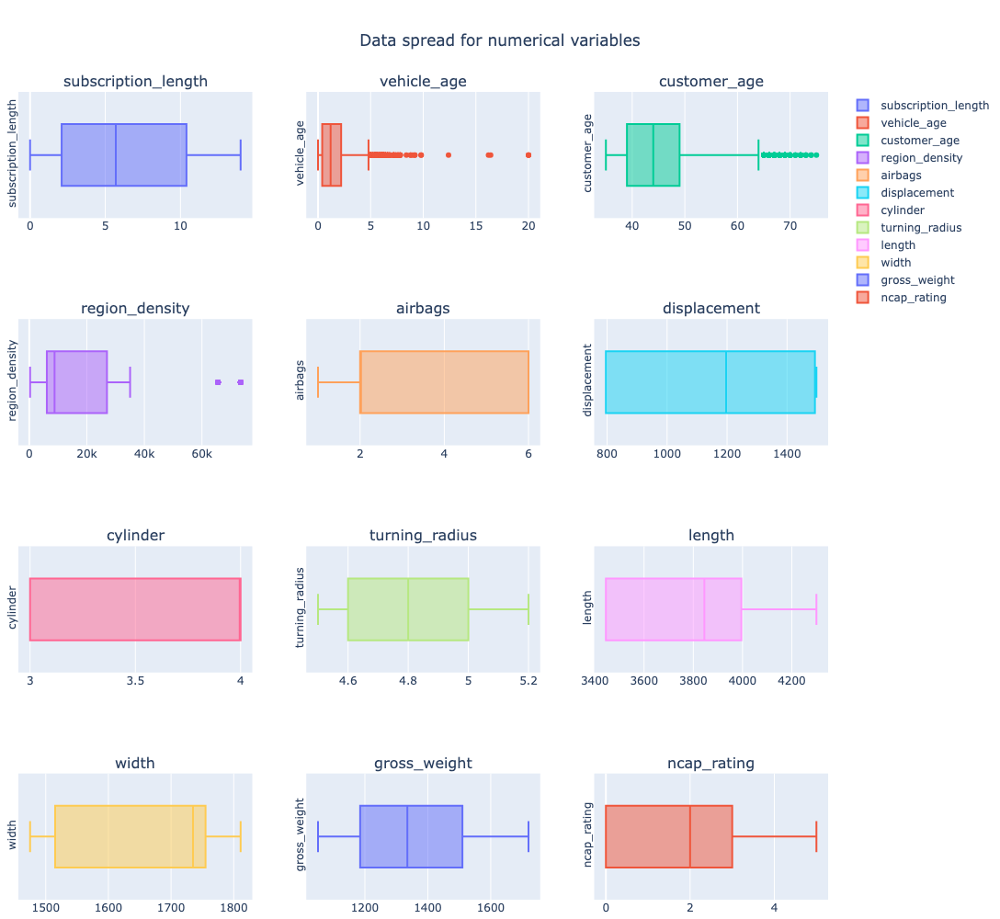

In [20]:
fig = make_subplots(rows=int(len(num_cols)/3), cols=3, subplot_titles=num_cols)

for n_row in range(int(len(num_cols)/3)):
    for n_col in range(3):
        index = n_row * 3 + n_col
        if index < len(num_cols):
            fig.add_trace(
                go.Box(
                    x=df[num_cols[index]], 
                    name=num_cols[index]
                    # This sets the legend name for each box plot
                ), 
                row=n_row+1, 
                col=n_col+1
            )

fig.update_layout(
    height=1000, 
    margin=dict(l=5, r=5, b=5),
    title=dict(
        text='Data spread for numerical variables', 
        x=0.5
    ),
    showlegend=True  # Ensure the legend is displayed
)
fig.update_yaxes(tickangle=270)
fig.show()

from the above box plots we can see that `vehicle age` and `customer age ` contains outliers

In [24]:
df.select_dtypes(exclude=['int64', 'float64']).info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 58592 entries, 0 to 58591
Data columns (total 28 columns):
 #   Column                            Non-Null Count  Dtype 
---  ------                            --------------  ----- 
 0   policy_id                         58592 non-null  object
 1   region_code                       58592 non-null  object
 2   segment                           58592 non-null  object
 3   model                             58592 non-null  object
 4   fuel_type                         58592 non-null  object
 5   max_torque                        58592 non-null  object
 6   max_power                         58592 non-null  object
 7   engine_type                       58592 non-null  object
 8   is_esc                            58592 non-null  object
 9   is_adjustable_steering            58592 non-null  object
 10  is_tpms                           58592 non-null  object
 11  is_parking_sensors                58592 non-null  object
 12  is_parking_camera 

since `policy_id` will not give any information for making predictions we are deleting the column

In [27]:
df.drop(columns=['policy_id'], inplace=True)

In [30]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 58592 entries, 0 to 58591
Data columns (total 40 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   subscription_length               58592 non-null  float64
 1   vehicle_age                       58592 non-null  float64
 2   customer_age                      58592 non-null  int64  
 3   region_code                       58592 non-null  object 
 4   region_density                    58592 non-null  int64  
 5   segment                           58592 non-null  object 
 6   model                             58592 non-null  object 
 7   fuel_type                         58592 non-null  object 
 8   max_torque                        58592 non-null  object 
 9   max_power                         58592 non-null  object 
 10  engine_type                       58592 non-null  object 
 11  airbags                           58592 non-null  int64  
 12  is_e

In [32]:
cat_cols = list(df.select_dtypes(include=['object']).columns)

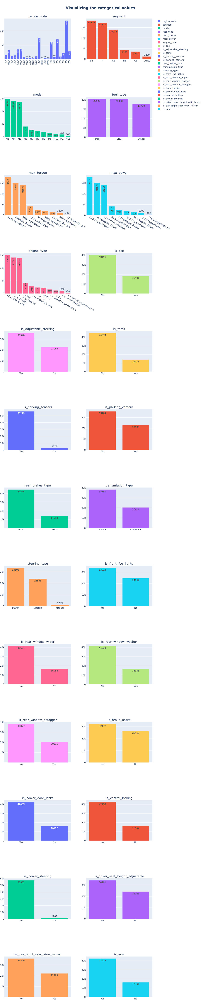

In [34]:
fig = make_subplots(rows= int(len(cat_cols)/2), cols=2, subplot_titles=cat_cols)

for row in range(int(len(cat_cols)/2)):
    for col in range(2):
        index = row * 2 + col
        if index< len(cat_cols):
            fig.add_trace(
                go.Bar(x = list(df[cat_cols[index]].value_counts().reset_index()[cat_cols[index]]),
                       y = list(df[cat_cols[index]].value_counts().reset_index()['count']),
                       name = cat_cols[index],
                       text = list(df[cat_cols[index]].value_counts().reset_index()['count']),
                ),
                row=row+1,
                col=col+1)

fig.update_layout(height = 200* len(cat_cols),
                  title = dict(text='<b>Visualizing the categorical values<b>', x = 0.5, font_size = 20),
                 margin = dict(l=0.5,r=0.5, b=0.5),
                 xaxis = dict(categoryorder = 'category ascending')
                 )

fig.show()

changing the all `is_.*` columns from **yes** = **1** and **no** = **0**

In [37]:
import re
is_start_cols = [ col for col in list(df.select_dtypes(include=['object']).columns) if re.search('is_.*', col)]
is_start_cols

['is_esc',
 'is_adjustable_steering',
 'is_tpms',
 'is_parking_sensors',
 'is_parking_camera',
 'is_front_fog_lights',
 'is_rear_window_wiper',
 'is_rear_window_washer',
 'is_rear_window_defogger',
 'is_brake_assist',
 'is_power_door_locks',
 'is_central_locking',
 'is_power_steering',
 'is_driver_seat_height_adjustable',
 'is_day_night_rear_view_mirror',
 'is_ecw',
 'is_speed_alert']

In [39]:
df[is_start_cols] = df[is_start_cols].replace('Yes', 1).replace('No',0)

/var/folders/dx/gf7c3wn55qs_lc37xdy2rkw00000gn/T/ipykernel_72346/1230541691.py:1: FutureWarning:

Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`



excluding the is_.* columns from cat_cols

In [42]:
cat_cols = [col for col in cat_cols if not re.search('is_.*', col)]
cat_cols

['region_code',
 'segment',
 'model',
 'fuel_type',
 'max_torque',
 'max_power',
 'engine_type',
 'rear_brakes_type',
 'transmission_type',
 'steering_type']

converting `transmission_type` & `rear_brakes_type` to numerical values

In [45]:
df['transmission_type'] = df['transmission_type'].apply(lambda x: 0 if x=='Manual' else 1)
df['rear_brakes_type']= df['rear_brakes_type'].apply(lambda x: 0 if x=='Drum' else 1)

cat_cols.remove('transmission_type')
cat_cols.remove('rear_brakes_type')

In [47]:
for i in range(len(cat_cols)):
    df_ = pd.get_dummies(df[cat_cols[i]],prefix=cat_cols[i]).astype('int64')
    df = pd.concat([df, df_], axis=1)
    df.drop(columns = [cat_cols[i]], inplace=True)

In [49]:
df

,subscription_length,vehicle_age,customer_age,region_density,airbags,is_esc,is_adjustable_steering,is_tpms,is_parking_sensors,is_parking_camera,...,engine_type_1.5 Turbocharged Revotorq,engine_type_1.5 Turbocharged Revotron,engine_type_F8D Petrol Engine,engine_type_G12B,engine_type_K Series Dual jet,engine_type_K10C,engine_type_i-DTEC,steering_type_Electric,steering_type_Manual,steering_type_Power
0,9.3,1.2,41,8794,6,1,1,1,1,1,...,0,0,0,0,0,0,0,0,0,1
1,8.2,1.8,35,27003,2,0,1,0,1,1,...,0,0,0,0,0,0,1,1,0,0
2,9.5,0.2,44,8794,6,1,1,1,1,1,...,0,0,0,0,0,0,0,0,0,1
3,5.2,0.4,44,73430,2,0,0,0,1,0,...,0,0,1,0,0,0,0,0,0,1
4,10.1,1.0,56,5410,2,0,1,0,1,0,...,1,0,0,0,0,0,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
58587,10.6,2.6,48,34738,2,0,1,0,1,0,...,0,0,0,0,1,0,0,1,0,0
58588,2.3,2.2,37,4076,6,1,1,1,1,1,...,0,0,0,0,0,0,0,0,0,1
58589,6.6,2.2,35,8794,2,0,1,0,1,0,...,0,0,0,0,1,0,0,1,0,0
58590,4.1,3.6,44,8794,2,0,1,0,1,0,...,0,0,0,0,1,0,0,1,0,0


## without balancing the dataset

In [54]:
cols = list(df.columns)

y_cols = 'claim_status'
X_cols = [col for col in cols if col != 'claim_status']

y = df[y_cols]
X = df[X_cols]

In [56]:
from sklearn.model_selection import train_test_split

In [57]:
X_train, X_test, y_train, y_test = train_test_split(X,y, test_size=0.2, stratify = y)

In [58]:
from collections import Counter
print(Counter(y_train))
print(Counter(y_test))

Counter({0: 43875, 1: 2998})
Counter({0: 10969, 1: 750})


## Model 1 - logistic regression

In [63]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, confusion_matrix, roc_curve, auc, classification_report

In [65]:
lr = LogisticRegression()
lr.fit(X_train, y_train)
y_pred = lr.predict(X_test)
y_pred_proba = lr.predict_proba(X_test)

print('Accuracy: ',round(accuracy_score(y_test, y_pred), 4))
print('Precision: ',round(precision_score(y_test, y_pred), 4))
print('Recall: ',round(recall_score(y_test, y_pred), 4))
print('f1 score: ',round(f1_score(y_test, y_pred), 4))
print('roc_auc_score: ',round(roc_auc_score(y_test, y_pred), 4))
print('Confusion matrix: \n',confusion_matrix(y_test, y_pred))

Accuracy:  0.936
Precision:  0.0
Recall:  0.0
f1 score:  0.0
roc_auc_score:  0.5
Confusion matrix: 
 [[10969     0]
 [  750     0]]


/opt/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_logistic.py:469: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

/opt/anaconda3/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.



## Model2 - Decision Tree Classifier

In [67]:
from sklearn.tree import DecisionTreeClassifier

In [70]:
dt = DecisionTreeClassifier()
dt.fit(X_train, y_train)

y_pred = dt.predict(X_test)

print('Accuracy: ',round(accuracy_score(y_test, y_pred), 4))
print('Precision: ',round(precision_score(y_test, y_pred), 4))
print('Recall: ',round(recall_score(y_test, y_pred), 4))
print('f1 score: ',round(f1_score(y_test, y_pred), 4))
print('roc_auc_score: ',round(roc_auc_score(y_test, y_pred), 4))
print('Confusion matrix: \n',confusion_matrix(y_test, y_pred))

Accuracy:  0.8752
Precision:  0.0841
Recall:  0.096
f1 score:  0.0897
roc_auc_score:  0.5123
Confusion matrix: 
 [[10185   784]
 [  678    72]]


**Observation**: from the above data and results  important metrics for model evalution is recall, precision and f1_score

## Balancing the dataset
1. Random Sampling
2. Synthetic Minority Over Technique(SMOTE)
3. Adaptive Synthetic sampling(ADASYN)

In [75]:
def plot_pie(lst):
    from collections import Counter
    dct= dict(Counter(lst))
    fig = go.Figure()
    fig.add_trace(
        go.Pie(
            values = list(dct.values()),
            labels = list(dct.keys())
        )
    )
    fig.update_layout(title=dict(text='Distribution of the values',
                                x=0.5))
    fig.show()


def plot_metrics(y_test, y_pred, y_pred_proba):
    print('Accuracy: ',round(accuracy_score(y_test, y_pred), 4))
    print('Precision: ',round(precision_score(y_test, y_pred), 4))
    print('Recall: ',round(recall_score(y_test, y_pred), 4))
    print('f1 score: ',round(f1_score(y_test, y_pred), 4))
    print('Confusion matrix: \n',confusion_matrix(y_test, y_pred))

    fpr, tpr, thresholds = roc_curve(y_test, y_pred_proba)
    fig = go.Figure()
    fig.add_trace(
        go.Scatter(x=fpr,
                  y= tpr,
                  name = f'ROC curve (AUC = {roc_auc_score(y_test, y_pred_proba):.2f})')
    )
    fig.add_trace(
        go.Scatter(x=[0,1],
                  y=[0,1],
                  mode='lines',
                  name='Random Classifier',
                  line=dict(dash='dash'))
    )
    fig.update_layout(
        title = 'ROC_AUC',
        xaxis_title = 'False Positive Rate',
        yaxis_title= 'True Positive Rate',
        width=700,
        height= 500
    )
    fig.show()

    print(classification_report(y_test, y_pred))

### 1. Random Oversampling

In [78]:
from imblearn.over_sampling import RandomOverSampler, SMOTE, ADASYN

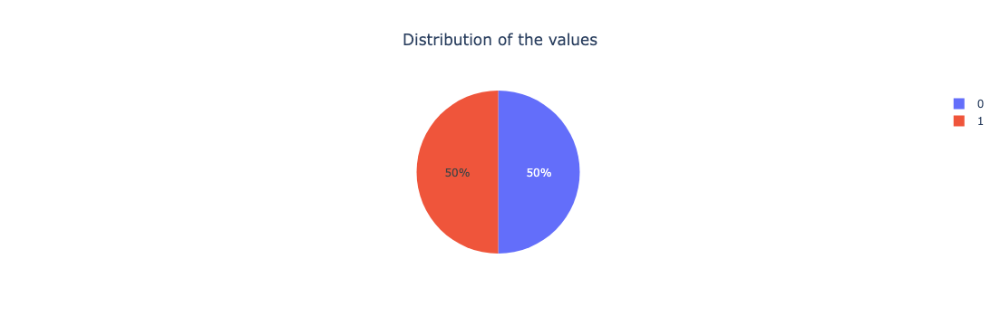

In [79]:
sampler1 = RandomOverSampler()
X_res1, y_res1 = sampler1.fit_resample(X,y)
plot_pie(y_res1)

### 2. SMOTE - Synthetic Minority Oversampling Technique

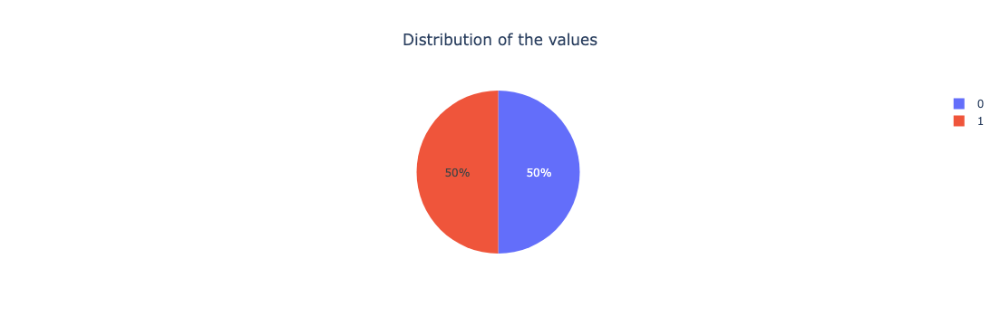

In [83]:
sampler2 = SMOTE()
X_res2, y_res2 = sampler2.fit_resample(X,y)
plot_pie(y_res2)

### 3. ADASYN - Adaptive synthetic Oversampling technique

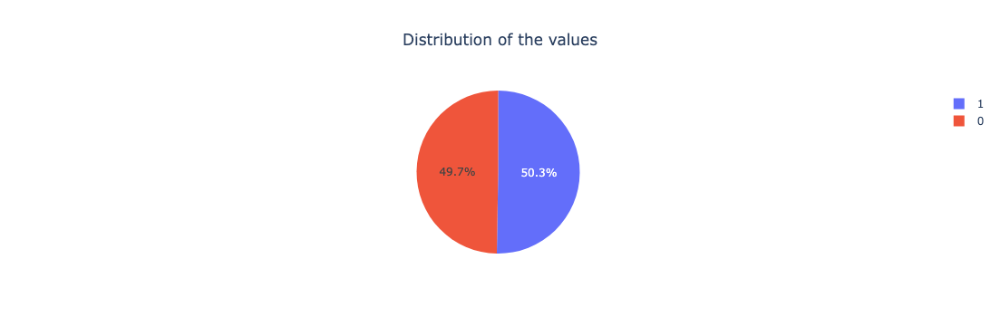

In [86]:
sampler3 = ADASYN()
X_res3, y_res3 = sampler3.fit_resample(X,y)
plot_pie(y_res3)

## Model3: Logistic Regression with RandomOversampling

/opt/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_logistic.py:469: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



Accuracy:  0.5636
Precision:  0.5641
Recall:  0.562
f1 score:  0.563
Confusion matrix: 
 [[6198 4766]
 [4807 6167]]


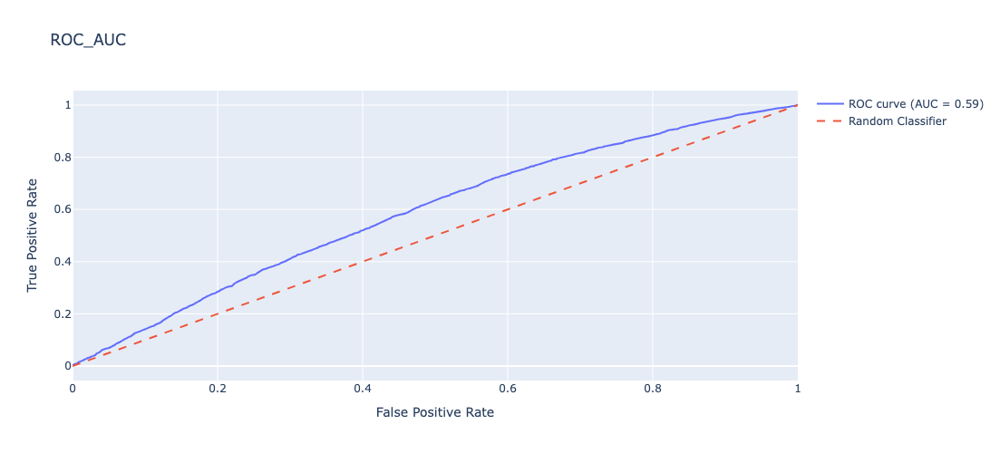

              precision    recall  f1-score   support

           0       0.56      0.57      0.56     10964
           1       0.56      0.56      0.56     10974

    accuracy                           0.56     21938
   macro avg       0.56      0.56      0.56     21938
weighted avg       0.56      0.56      0.56     21938



In [89]:
X_train, X_test, y_train, y_test = train_test_split(X_res1,y_res1, test_size=0.2)
lr = LogisticRegression()
lr = lr.fit(X_train, y_train)
y_pred = lr.predict(X_test)
y_pred_proba = lr.predict_proba(X_test)
plot_metrics(y_test, y_pred, y_pred_proba[:, 1])

## Model4: Logistic Regression with SMOTE

Accuracy:  0.5764
Precision:  0.5745
Recall:  0.6044
f1 score:  0.5891
Confusion matrix: 
 [[5983 4934]
 [4360 6661]]


/opt/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_logistic.py:469: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



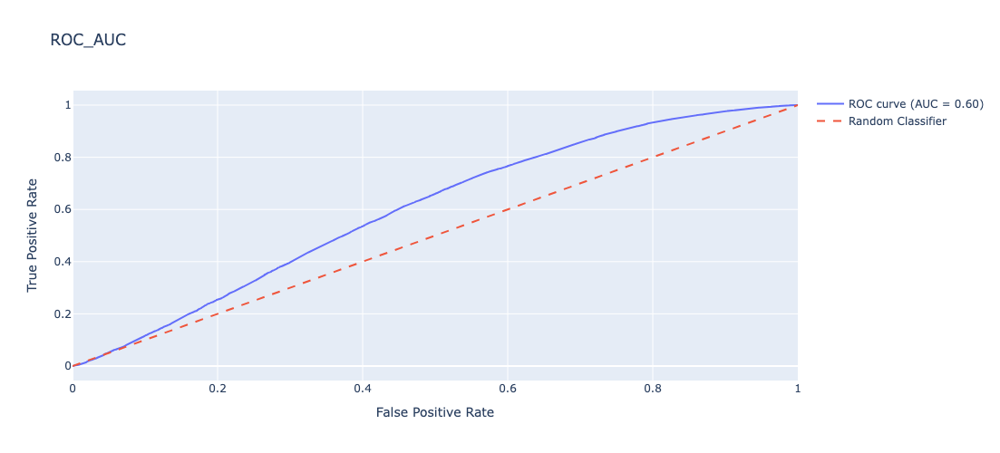

              precision    recall  f1-score   support

           0       0.58      0.55      0.56     10917
           1       0.57      0.60      0.59     11021

    accuracy                           0.58     21938
   macro avg       0.58      0.58      0.58     21938
weighted avg       0.58      0.58      0.58     21938



In [91]:
X_train, X_test, y_train, y_test = train_test_split(X_res2, y_res2, test_size=0.2)
lr = LogisticRegression()
lr.fit(X_train, y_train)
y_pred = lr.predict(X_test)
y_pred_proba = lr.predict_proba(X_test)
plot_metrics(y_test, y_pred, y_pred_proba[:, 1])

## Model 5: Logistic Regression with ADASYN

Accuracy:  0.5785
Precision:  0.5707
Recall:  0.6128
f1 score:  0.591
Confusion matrix: 
 [[6042 5053]
 [4244 6717]]


/opt/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_logistic.py:469: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



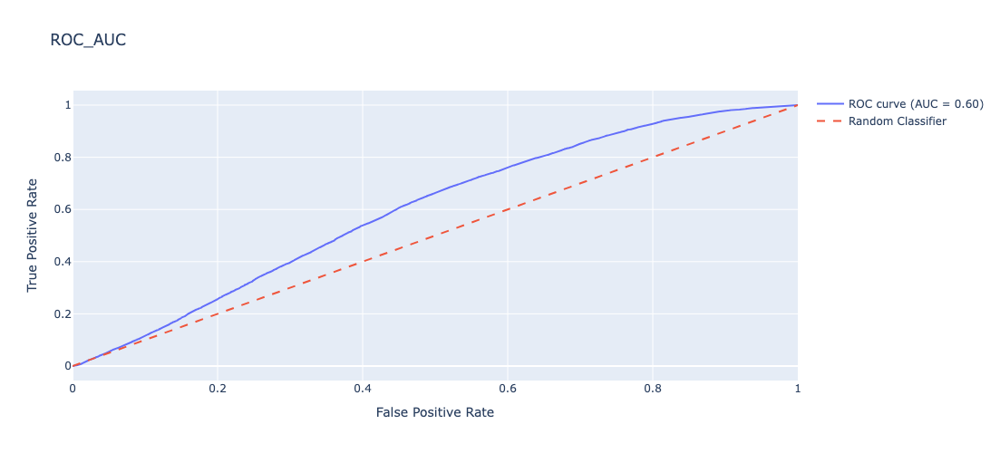

              precision    recall  f1-score   support

           0       0.59      0.54      0.57     11095
           1       0.57      0.61      0.59     10961

    accuracy                           0.58     22056
   macro avg       0.58      0.58      0.58     22056
weighted avg       0.58      0.58      0.58     22056



In [94]:
X_train,X_test,y_train,y_test = train_test_split(X_res3, y_res3,test_size=0.2)
lr = LogisticRegression()
lr.fit(X_train,y_train)
y_pred = lr.predict(X_test)
y_pred_proba = lr.predict_proba(X_test)
plot_metrics(y_test, y_pred, y_pred_proba[:, 1])

## Model 6: Decision Tree Classifier with RandomOversample

Accuracy:  0.9573
Precision:  0.9214
Recall:  1.0
f1 score:  0.9591
Confusion matrix: 
 [[10031   936]
 [    0 10971]]


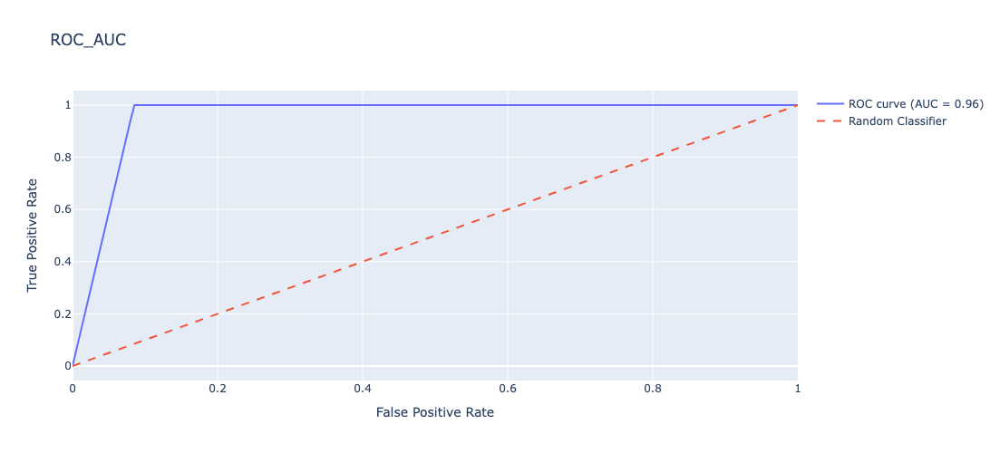

              precision    recall  f1-score   support

           0       1.00      0.91      0.96     10967
           1       0.92      1.00      0.96     10971

    accuracy                           0.96     21938
   macro avg       0.96      0.96      0.96     21938
weighted avg       0.96      0.96      0.96     21938



In [98]:
X_train, X_test, y_train, y_test = train_test_split(X_res1, y_res1, test_size=0.2)
dt = DecisionTreeClassifier()
dt.fit(X_train, y_train)
y_pred = dt.predict(X_test)
y_pred_proba = dt.predict_proba(X_test)
plot_metrics(y_test, y_pred, y_pred_proba[:, 1])

## Model 7: Decision Tree Classifier with SMOTE

Accuracy:  0.9214
Precision:  0.9136
Recall:  0.9301
f1 score:  0.9218
Confusion matrix: 
 [[10053   961]
 [  764 10160]]


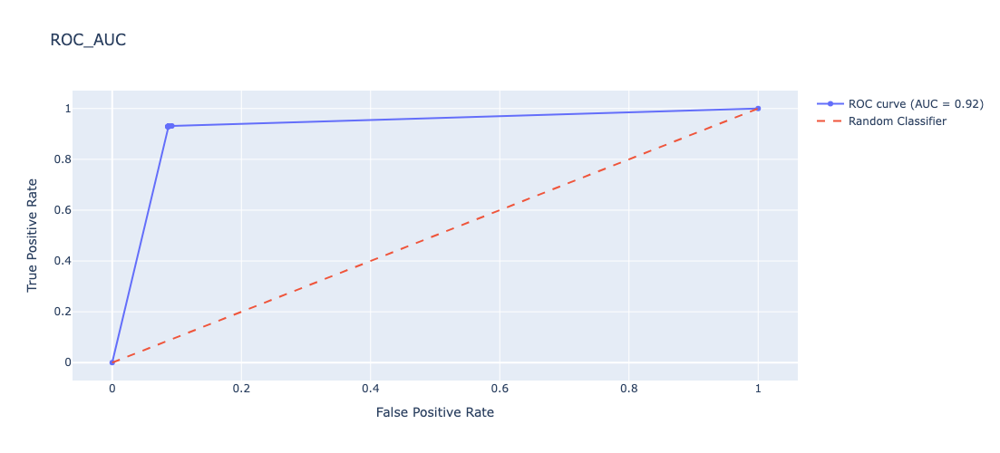

              precision    recall  f1-score   support

           0       0.93      0.91      0.92     11014
           1       0.91      0.93      0.92     10924

    accuracy                           0.92     21938
   macro avg       0.92      0.92      0.92     21938
weighted avg       0.92      0.92      0.92     21938



In [102]:
X_train, X_test, y_train, y_test = train_test_split(X_res2, y_res2, test_size=0.2)
dt = DecisionTreeClassifier()
dt.fit(X_train, y_train)
y_pred = dt.predict(X_test)
y_pred_proba = dt.predict_proba(X_test)
plot_metrics(y_test, y_pred, y_pred_proba[:, 1])

## Model 8: Decision Tree Classifier with ADASYN

Accuracy:  0.9226
Precision:  0.9171
Recall:  0.9295
f1 score:  0.9232
Confusion matrix: 
 [[10083   928]
 [  779 10266]]


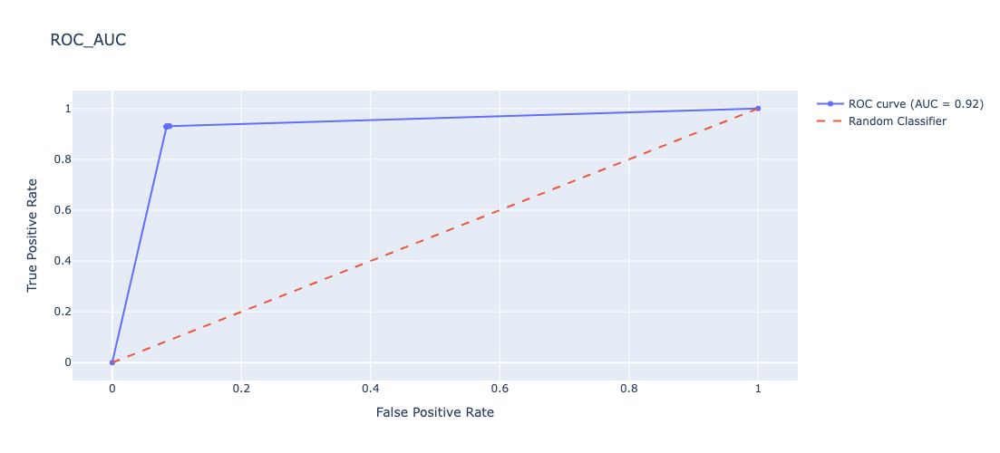

              precision    recall  f1-score   support

           0       0.93      0.92      0.92     11011
           1       0.92      0.93      0.92     11045

    accuracy                           0.92     22056
   macro avg       0.92      0.92      0.92     22056
weighted avg       0.92      0.92      0.92     22056



In [106]:
X_train, X_test, y_train, y_test = train_test_split(X_res3, y_res3, test_size=0.2)
dt = DecisionTreeClassifier()
dt.fit(X_train, y_train)
y_pred = dt.predict(X_test)
y_pred_proba = dt.predict_proba(X_test)
plot_metrics(y_test, y_pred, y_pred_proba[:, 1])

## Model 9: Random Forest classifier with Random over sampler

In [109]:
from sklearn.ensemble import RandomForestClassifier

Accuracy:  0.9787
Precision:  0.9593
Recall:  1.0
f1 score:  0.9792
Confusion matrix: 
 [[10464   467]
 [    0 11007]]


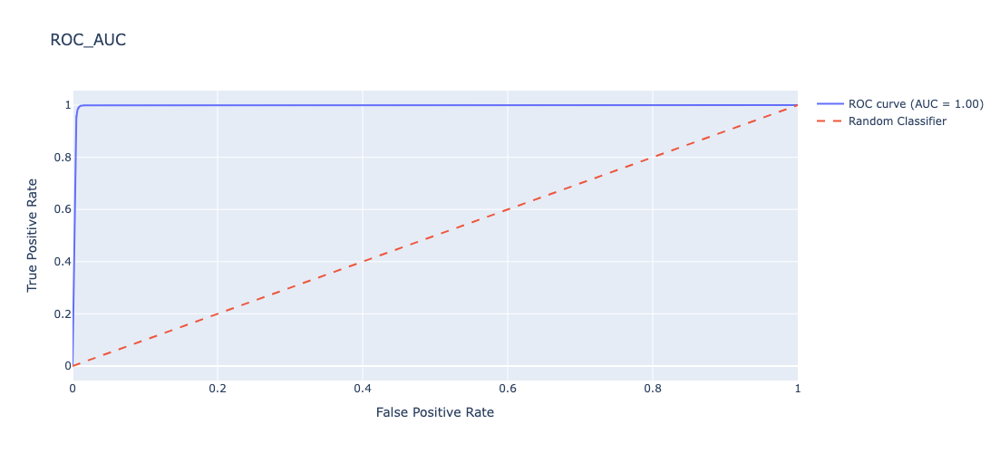

              precision    recall  f1-score   support

           0       1.00      0.96      0.98     10931
           1       0.96      1.00      0.98     11007

    accuracy                           0.98     21938
   macro avg       0.98      0.98      0.98     21938
weighted avg       0.98      0.98      0.98     21938



In [111]:
X_train, X_test, y_train, y_test = train_test_split(X_res1, y_res1, test_size=0.2)
rf = RandomForestClassifier()
rf.fit(X_train, y_train)
y_pred = rf.predict(X_test)
y_pred_proba = rf.predict_proba(X_test)
plot_metrics(y_test, y_pred, y_pred_proba[:, 1])

## Model 10: Random Forest Classifier with SMOTE

Accuracy:  0.8958
Precision:  0.8887
Recall:  0.9053
f1 score:  0.8969
Confusion matrix: 
 [[9699 1246]
 [1041 9952]]


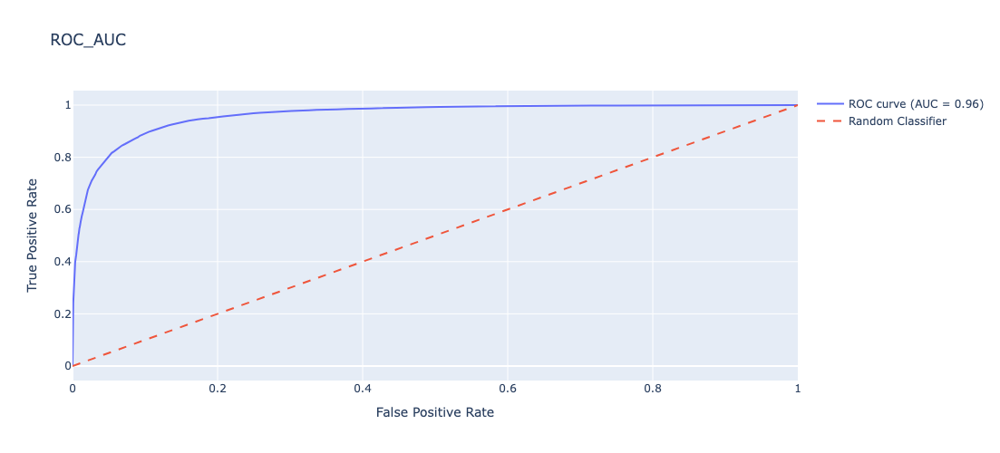

              precision    recall  f1-score   support

           0       0.90      0.89      0.89     10945
           1       0.89      0.91      0.90     10993

    accuracy                           0.90     21938
   macro avg       0.90      0.90      0.90     21938
weighted avg       0.90      0.90      0.90     21938



In [68]:
X_train, X_test, y_train, y_test = train_test_split(X_res2, y_res2, test_size=0.2)
rf = RandomForestClassifier()
rf.fit(X_train, y_train)
y_pred = rf.predict(X_test)
y_pred_proba = rf.predict_proba(X_test)
plot_metrics(y_test, y_pred, y_pred_proba[:, 1])

## Model 11: Random Forest Classifier with ADASYN

Accuracy:  0.8972
Precision:  0.8891
Recall:  0.9084
f1 score:  0.8986
Confusion matrix: 
 [[ 9738  1254]
 [ 1014 10050]]


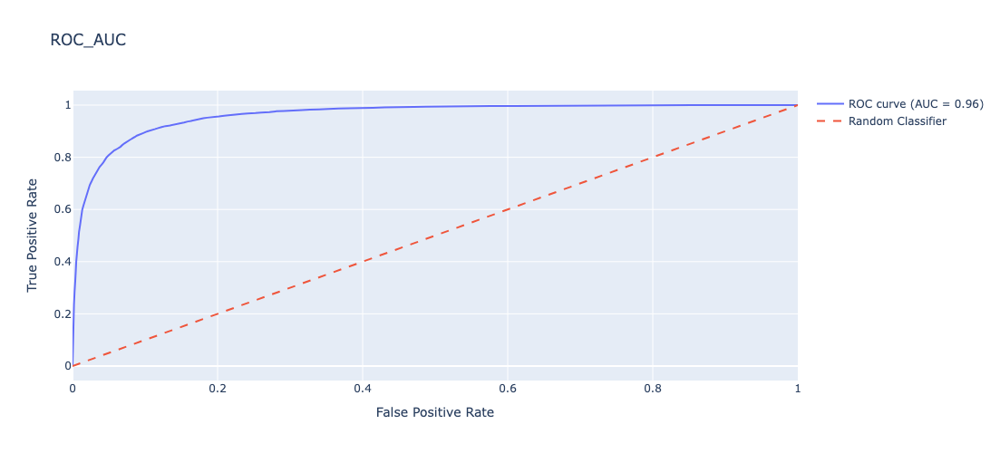

              precision    recall  f1-score   support

           0       0.91      0.89      0.90     10992
           1       0.89      0.91      0.90     11064

    accuracy                           0.90     22056
   macro avg       0.90      0.90      0.90     22056
weighted avg       0.90      0.90      0.90     22056



In [70]:
X_train, X_test, y_train, y_test = train_test_split(X_res3, y_res3, test_size=0.2)
rf = RandomForestClassifier()
rf.fit(X_train, y_train)
y_pred = rf.predict(X_test)
y_pred_proba = rf.predict_proba(X_test)
plot_metrics(y_test, y_pred, y_pred_proba[:, 1])

In [125]:
feature_importance = rf.feature_importances_
features_df = pd.DataFrame({'columns': list(X.columns), 'Importance': list(feature_importance)})
features_df

,columns,Importance
0,subscription_length,0.364596
1,vehicle_age,0.359540
2,customer_age,0.175224
3,region_density,0.021550
4,airbags,0.000692
...,...,...
100,engine_type_K10C,0.000152
101,engine_type_i-DTEC,0.000173
102,steering_type_Electric,0.000308
103,steering_type_Manual,0.000112


## Final Model using the best Features

In [144]:
features_df = features_df.head(10)
important_cols = list(features_df['columns'])

Accuracy:  0.984
Precision:  0.969
Recall:  1.0
f1 score:  0.9843
Confusion matrix: 
 [[10585   352]
 [    0 11001]]


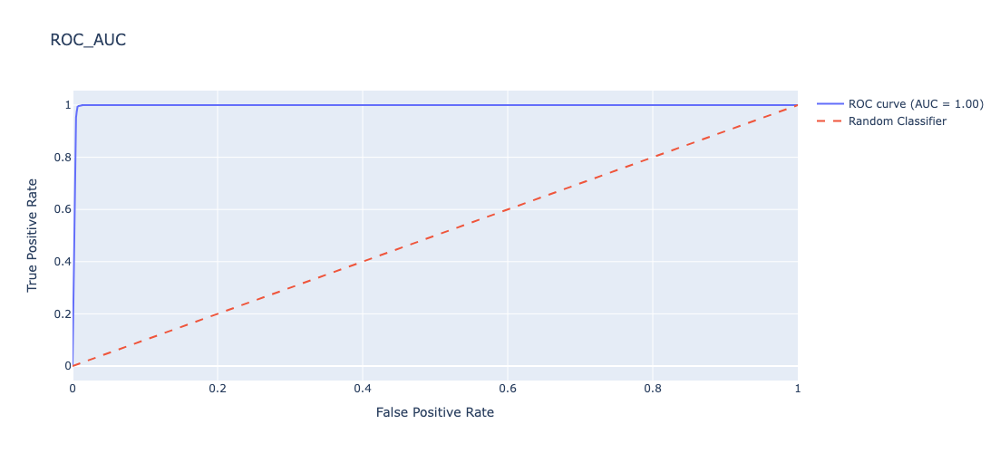

              precision    recall  f1-score   support

           0       1.00      0.97      0.98     10937
           1       0.97      1.00      0.98     11001

    accuracy                           0.98     21938
   macro avg       0.98      0.98      0.98     21938
weighted avg       0.98      0.98      0.98     21938



In [140]:
X = X[important_cols]
X_res1, y_res1 = sampler1.fit_resample(X,y)
X_train, X_test, y_train, y_test = train_test_split(X_res1, y_res1, test_size=0.2)
rf = RandomForestClassifier()
rf.fit(X_train, y_train)
y_pred = rf.predict(X_test)
y_pred_proba = rf.predict_proba(X_test)
plot_metrics(y_test, y_pred, y_pred_proba[:, 1])

Accuracy:  0.9249
Precision:  0.9312
Recall:  0.9171
f1 score:  0.9241
Confusion matrix: 
 [[10257   741]
 [  907 10033]]


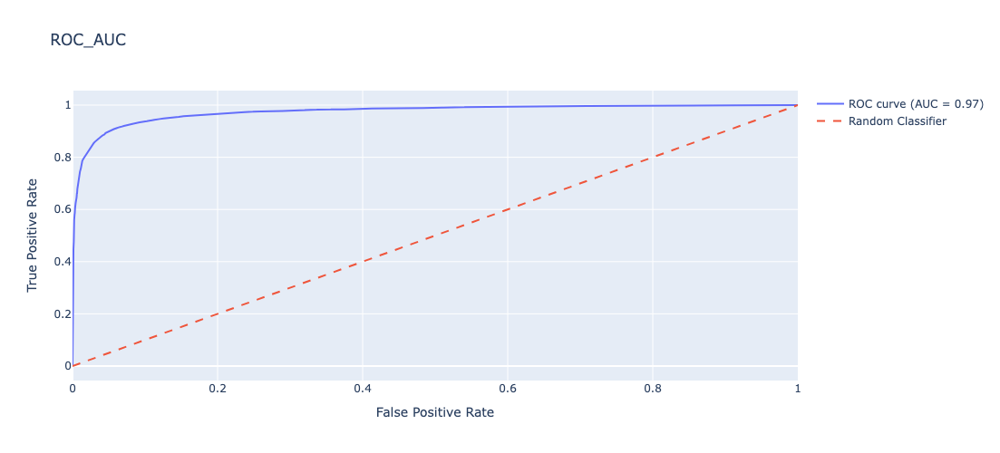

              precision    recall  f1-score   support

           0       0.92      0.93      0.93     10998
           1       0.93      0.92      0.92     10940

    accuracy                           0.92     21938
   macro avg       0.92      0.92      0.92     21938
weighted avg       0.92      0.92      0.92     21938



In [146]:
X = X[important_cols]
X_res, y_res= sampler2.fit_resample(X,y)
X_train, X_test, y_train, y_test = train_test_split(X_res, y_res, test_size=0.2)
rf = RandomForestClassifier()
rf.fit(X_train, y_train)
y_pred = rf.predict(X_test)
y_pred_proba = rf.predict_proba(X_test)
plot_metrics(y_test, y_pred, y_pred_proba[:, 1])

Accuracy:  0.9258
Precision:  0.9304
Recall:  0.9213
f1 score:  0.9258
Confusion matrix: 
 [[10206   763]
 [  872 10202]]


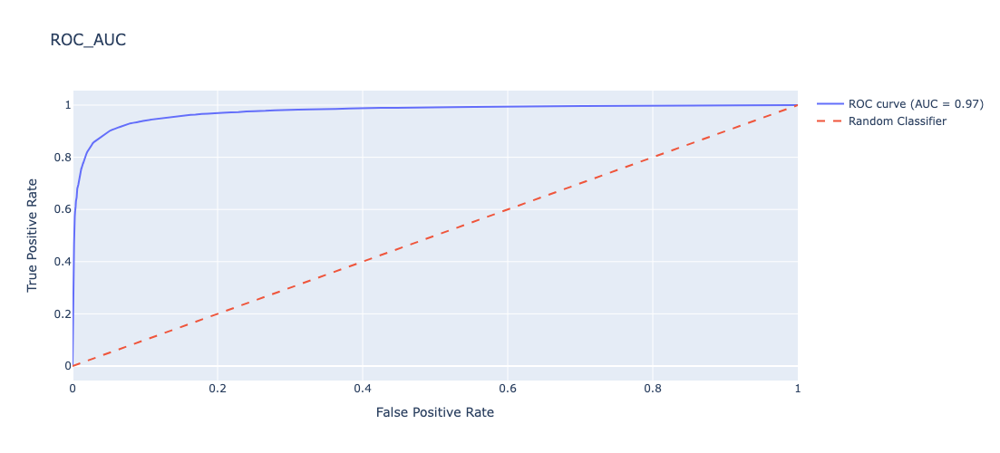

              precision    recall  f1-score   support

           0       0.92      0.93      0.93     10969
           1       0.93      0.92      0.93     11074

    accuracy                           0.93     22043
   macro avg       0.93      0.93      0.93     22043
weighted avg       0.93      0.93      0.93     22043



In [148]:
X = X[important_cols]
X_res, y_res= sampler3.fit_resample(X,y)
X_train, X_test, y_train, y_test = train_test_split(X_res, y_res, test_size=0.2)
rf = RandomForestClassifier()
rf.fit(X_train, y_train)
y_pred = rf.predict(X_test)
y_pred_proba = rf.predict_proba(X_test)
plot_metrics(y_test, y_pred, y_pred_proba[:, 1])

## Conclusion:
1. based on the input data provided it contains the imbalanced data which requires the oversampling method. we have used `RandomOverSampling`.
2. we tried with `LogisticRegression`, `DecisionTreeClassifier` & `RandomForestClassifier` and the results were good in Randomforest.
3. As mentioned above for the problem statement `Recall` is the important metrics and the best model RandomForestClassifier with Randomoversampling gave `Recall score : 0.98`